In [1]:
import numpy as np
import time
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import cv2
import os
from skimage import img_as_bool, io, color, morphology
import math
from scipy import ndimage
import re

In [2]:
def scaled(d):
    return np.divide(d-d.min(), d.max()-d.min(), dtype="float32")

def formating(d):
    result=scaled(d)*255
    return result.astype('uint8')

In [3]:
def align_images(image, template, msk="None", maxFeatures=500, keepPercent=0.2, debug=False): #
	# convert both the input image and template to grayscale
    imageGray = image #cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    templateGray = template #cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)
    # use ORB to detect keypoints and extract (binary) local
    # invariant features
    orb = cv2.ORB_create(maxFeatures)
    (kpsA, descsA) = orb.detectAndCompute(imageGray, None)
    (kpsB, descsB) = orb.detectAndCompute(templateGray, None)
    # match the features
    method = cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING
    matcher = cv2.DescriptorMatcher_create(method)
    matches = matcher.match(descsA, descsB, None)
    # sort the matches by their distance (the smaller the distance
    # the "more similar" the features are)
    matches = sorted(matches, key=lambda x:x.distance)
    # keep only the top matches
    keep = int(len(matches) * keepPercent)
    matches = matches[:keep]
    # check to see if we should visualize the matched keypoints
    #if debug:
		#matchedVis = cv2.drawMatches(image, kpsA, template, kpsB, matches, None)
		#matchedVis = imutils.resize(matchedVis, width=1000)
		#cv2.imshow("Matched Keypoints", matchedVis)
		#cv2.waitKey(0)

    # allocate memory for the keypoints (x, y)-coordinates from the
	# top matches -- we'll use these coordinates to compute our
    # homography matrix
    ptsA = np.zeros((len(matches), 2), dtype="float")
    ptsB = np.zeros((len(matches), 2), dtype="float")
    # loop over the top matches
    for (i, m) in enumerate(matches):
		# indicate that the two keypoints in the respective images
		# map to each other
        ptsA[i] = kpsA[m.queryIdx].pt
        ptsB[i] = kpsB[m.trainIdx].pt

    # compute the homography matrix between the two sets of matched
    # points
    (H, mask) = cv2.findHomography(ptsA, ptsB, method=cv2.RANSAC)
    # use the homography matrix to align the images
    (h, w) = template.shape[:2]
    aligned = cv2.warpPerspective(image, H, (w, h))
    if msk != "None":
        aligned_mask = cv2.warpPerspective(msk, H, (w, h))
    else:
        aligned_mask = "None"
    # return the aligned image
    return aligned , aligned_mask

In [5]:
directory="D:/Hyperspectral data/Templates_4alingment/29_April/"  #dir for alignment
#directory="D:/Hyperspectral data/Templates_4alingment/29_April/" 
directory1= "D:/Hyperspectral data/Templates_4alingment/18_March/"#"D:/Hyperspectral data/Templates_4alingment/Cosmo_pro_templates/"  # dir for template
l = os.listdir(directory)
l1 = os.listdir(directory1)
#image=np.load(directory+"s1_AP3_March.npy")
#template=np.load(directory+"s1_AP3_April.npy")

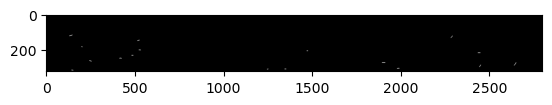

In [7]:
directory2="D:/Hyperspectral data/Aligned_masks/Soil_march18/new/"#"D:/Hyperspectral data/swir_masks_4Cosmo_pro/" #dir for Cosmo masks
l2 = os.listdir(directory2)
msk=cv2.imread(directory2+"stride_1_20210318120855_AP_3_soil.png")
plt.imshow(msk)

## SWIR alignement

stride_1_20210318113419_UD_3
stride_1_20210429155937_UD_3_
stride_1_20210318120855_AP_3
stride_1_20210429152655_AP_3_
stride_2_20210318113502_UD_3
stride_2_20210429160030_UD_3_
stride_2_20210318114631_UD_1
stride_2_20210429160729_UD_1_
stride_2_20210318115748_DF_1
stride_2_20210429165060_DF_1_
stride_3_20210318121555_AP_2
stride_3_20210429154745_AP_2_
stride_4_20210318121633_AP_2
stride_4_20210429154838_AP_2_
stride_5_20210318114830_UD_1
stride_5_20210429161011_UD_1 _
stride_5_20210318115410_DF_2
stride_5_20210429164620_DF_2 _
stride_5_20210318121132_AP_3
stride_5_20210429153029_AP_3 _
stride_6_20210318114339_UD_2
stride_6_20210429155720_UD_2_
stride_6_20210318114908_UD_1
stride_6_20210429161104_UD_1_
stride_6_20210318115449_DF_2
stride_6_20210429164717_DF_2_
stride_6_20210318120641_DF_3
stride_6_20210429163951_DF_3_
stride_6_20210318121750_AP_2
stride_6_20210429155023_AP_2_
stride_7_20210318114417_UD_2
stride_7_20210429155812_UD_2_
stride_7_20210318115527_DF_2
stride_7_20210429164810_

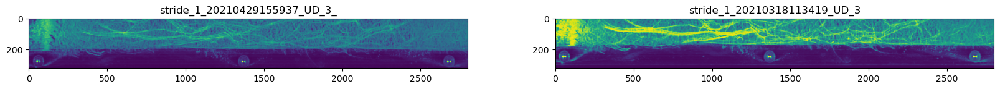

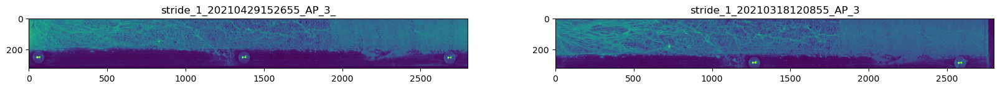

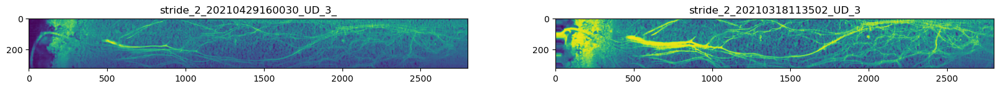

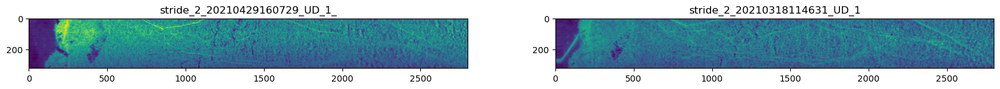

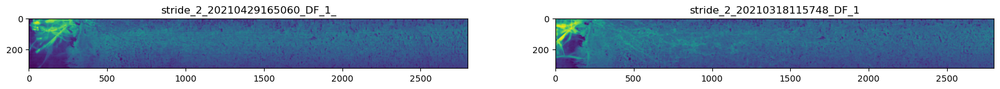

...

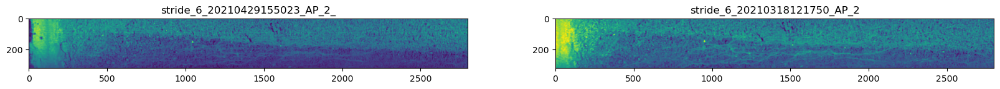

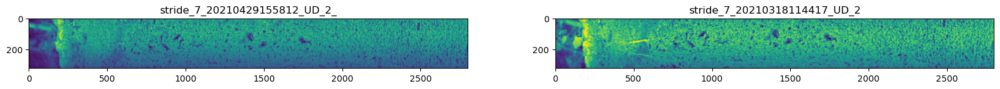

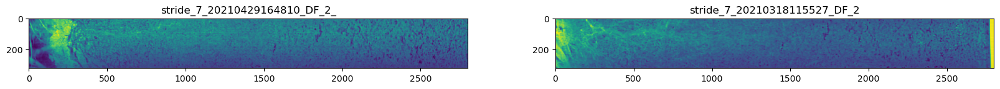

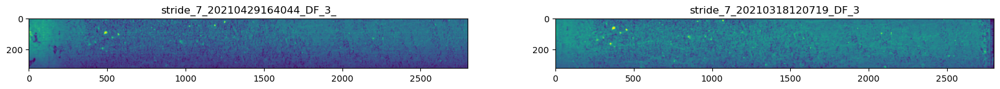

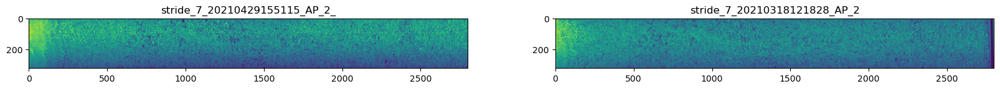

In [52]:
#aligned, al_msk =align_images( formating(template),formating(image),msk=np.rot90(msk) )
# show the alignement
boxes=["UD_3","UD_2","UD_1","DF_3","DF_2","DF_1","AP_3","AP_2","AP_1"]

for i in l2:
    if "_mask.png" in i:
        mask = cv2.imread(directory2+i)
        mask = np.flip(mask,axis=0)
        msk2=(mask[:,:2800,1]-255)*(-1)
        name=re.split("_mask.png", i)[0]
        strd=re.split("_", name)[0:2]
        stride=str(strd[0]+"_"+strd[1])
        print(name)
        for j in l1:
            if name in j:
                #print("yes")
                template=np.load(directory1+j)
            
        for box in boxes:
            if box in name:
                #print(box)
                for filename in l:
                    if box in filename and stride in filename:
                        #print(filename)
                        image=np.load(directory+filename)
                        newname=re.split("template.npy", filename)[0]
                        print(newname)
                        
                        figure(figsize=(20,20))
                        plt.subplot(1, 2, 1)
                        plt.title(newname)
                        plt.imshow(image) #np.flip(m,axis=2)
                            #plt.imshow(mask)
                        plt.subplot(1, 2, 2)
                        plt.title(name)
                        plt.imshow(template[:,:2800])
                        
                break
        
        
            

stride_1_20210429155937_UD_3_


C:\ProgramData\Anaconda3\envs\Image_processing\lib\site-packages\ipykernel_launcher.py:45: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


stride_1_20210429155248_UD_2_
stride_1_20210429160637_UD_1_
stride_1_20210429165008_DF_1_
stride_1_20210429152655_AP_3_
stride_1_20210429153908_AP_1_
stride_2_20210429160030_UD_3_
stride_2_20210429160729_UD_1_
stride_2_20210429163620_DF_3_
stride_2_20210429152747_AP_3_
stride_2_20210429154653_AP_2_
stride_2_20210429154005_AP_1_
stride_3_20210429160123_UD_3_
stride_3_20210429155438_UD_2_
stride_3_20210429160821_UD_1_
stride_3_20210429165154_DF_1_
stride_3_20210429152844_AP_3_
stride_3_20210429154745_AP_2_
stride_3_20210429154057_AP_1_
stride_4_20210429160220_UD_3_
stride_4_20210429155530_UD_2_


C:\ProgramData\Anaconda3\envs\Image_processing\lib\site-packages\ipykernel_launcher.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


stride_4_20210429160914_UD_1_
stride_4_20210429164528_DF_2_
stride_4_20210429165246_DF_1_
stride_4_20210429152937_AP_3_
stride_4_20210429154838_AP_2_
stride_4_20210429154150_AP_1_
stride_5_20210429155622_UD_2 _
stride_5_20210429161011_UD_1 _
stride_5_20210429164620_DF_2 _
stride_5_20210429165339_DF_1 _
stride_5_20210429153029_AP_3 _
stride_5_20210429154930_AP_2 _
stride_5_20210429154242_AP_1 _
stride_6_20210429160405_UD_3_
stride_6_20210429155720_UD_2_
stride_6_20210429161104_UD_1_
stride_6_20210429164717_DF_2_
stride_6_20210429165432_DF_1_
stride_6_20210429163951_DF_3_
stride_6_20210429153121_AP_3_
stride_6_20210429155023_AP_2_
stride_6_20210429154334_AP_1_
stride_7_20210429160458_UD_3_
stride_7_20210429155812_UD_2_
stride_7_20210429161156_UD_1_
stride_7_20210429165524_DF_1_
stride_7_20210429164044_DF_3_
stride_7_20210429153218_AP_3_
stride_7_20210429155115_AP_2_
stride_7_20210429154432_AP_1_


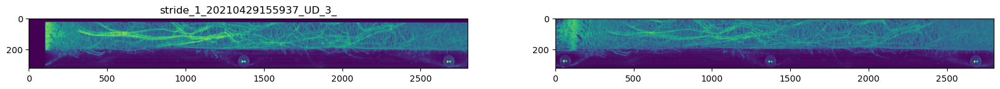

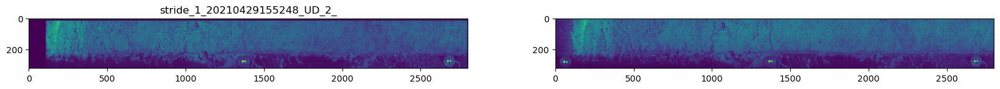

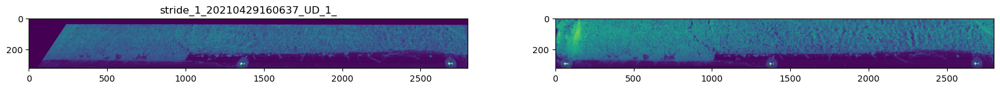

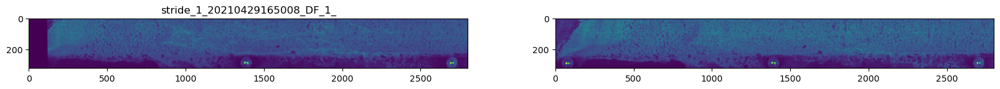

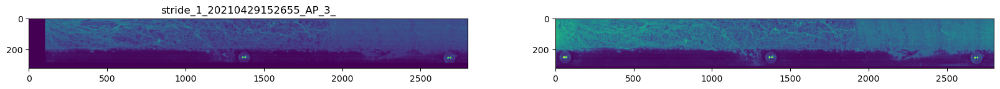

...

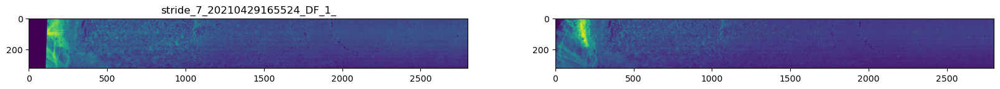

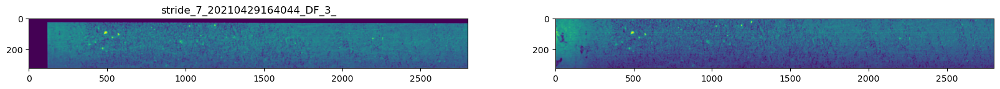

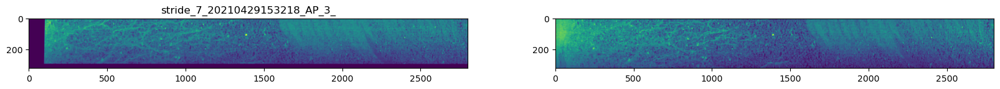

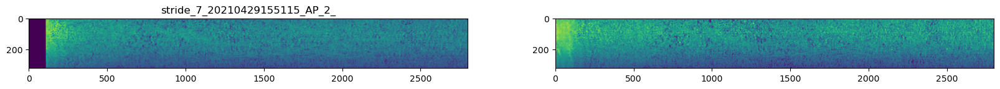

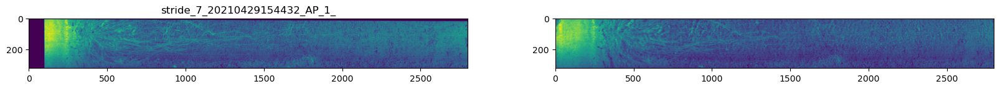

In [8]:
directory3="D:/Hyperspectral data/Aligned_masks/29_April/"
boxes=["UD_3","UD_2","UD_1","DF_3","DF_2","DF_1","AP_3","AP_2","AP_1"]

for i in l2:   # mask directory
    if "_soil.png" in i: #dark
        mask = cv2.imread(directory2+i) # mask read
        mask = np.flip(mask,axis=0)
        #msk2=(mask[:,:2800,1]-255)*(-1)
        name=re.split("_soil.png", i)[0]
        strd=re.split("_", name)[0:2]
        stride=str(strd[0]+"_"+strd[1])
        #print(name)
        for j in l1: #template image directory
            if name in j:
                #print("yes")
                template=np.load(directory1+j) # template image that have the mask
            
        for box in boxes:
            if box in name:
                #print(box)
                for filename in l:
                    if box in filename and stride in filename:
                        #print(filename)
                        image=np.load(directory+filename) # image to align with
                        newname=re.split("template.npy", filename)[0]
                        print(newname)
                        aligned, al_msk =align_images( formating(template),formating(image),msk=mask, maxFeatures=1500)#
                        cv2.imwrite(directory3+newname+"soil.png",al_msk) # storing the aligned mask
                        figure(figsize=(20,20))
                        plt.subplot(1, 2, 1)
                        plt.title(newname)
                        plt.imshow(aligned) #np.flip(m,axis=2)
                            #plt.imshow(mask)
                        plt.subplot(1, 2, 2)
                        #plt.title(name)
                        plt.imshow(image) #mask[:,:2800]-al_msk[:,:2800]
                        
                break

In [8]:
i

'stride_1_20210318113419_UD_3_mask.png'

## NIR alignment trial

In [6]:
# nir mask and image
nir_mask = cv2.imread("D:/Hyperspectral data/VIS-NIR/visnir_18_march/Ap3_white_mask.png")
nir_img = cv2.imread("D:/Hyperspectral data/VIS-NIR/visnir_18_march/764_Ap3(stress)/764.png")

In [8]:
directory3="D:/Hyperspectral data/"
nir_img = np.load(directory3+"test.npy")

In [9]:
nir_img.shape

(512, 512, 3)

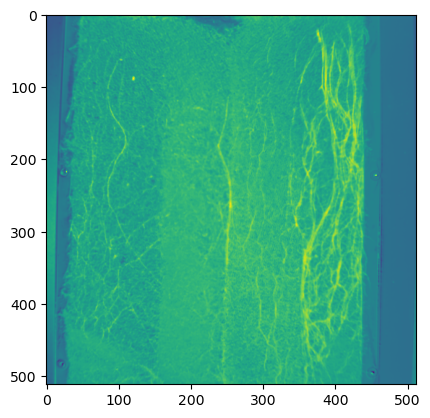

In [18]:
plt.imshow(scaled(nir_img[:,:,2]))

In [19]:
image = np.load(directory+"stride_1_20210318113419_UD_3_template.npy")
image.shape

(320, 2801)

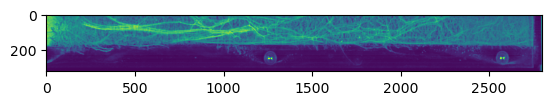

In [20]:
plt.imshow(image)

In [7]:
import skimage.exposure as skie
m = skie.adjust_log(nir_img)
gray = cv2.cvtColor(m, cv2.COLOR_BGR2GRAY)
circles1 = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, dp=1, minDist=50, param1=50, param2=30, minRadius=0, maxRadius=0)

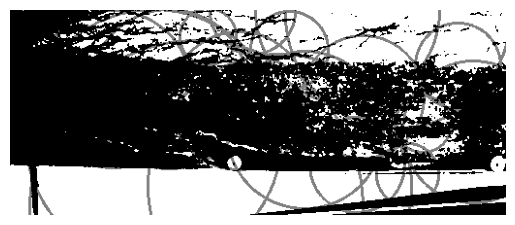

In [43]:
circles1 = cv2.HoughCircles(G, cv2.HOUGH_GRADIENT, dp=1, minDist=50, param1=50, param2=30, minRadius=0, maxRadius=0)

# Check if any circles were detected
if circles1 is not None:
    # Convert the (x, y) coordinates and radius of the circles to integers
    circles1 = np.round(circles1[0, :]).astype("int")

    # Draw the detected circles on the grayscale image
    g = G.copy()
    for (x, y, r) in circles1:
        cv2.circle(g, (x, y), r, (0, 255, 0), 2)

    # Display the grayscale image with the detected circles using plt.imshow
    plt.imshow(cv2.cvtColor(G, cv2.COLOR_BGR2RGB))
    plt.imshow(g, cmap='gray', alpha=0.5)
    plt.axis('off')
    plt.show()
else:
    print("No circles found.")

In [44]:
edges = cv2.Canny(G, 90, 100)

In [49]:
params = cv2.SimpleBlobDetector_Params()
params.filterByCircularity = True
params.minCircularity = 0.8
params.filterByArea = True
params.minArea = 10
params.maxArea = 5000

In [50]:
detector = cv2.SimpleBlobDetector_create(params)
keypoints = detector.detect(gray)
circles = np.round(cv2.KeyPoint_convert(keypoints)).astype("int")
edges=G.copy()
for (x, y) in circles:
    cv2.circle(edges, (x, y), 3, (0, 255, 0), -1)

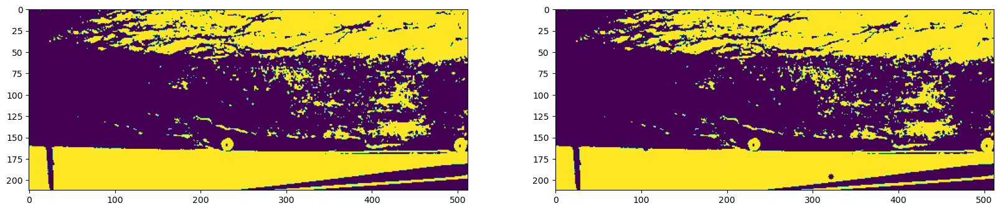

In [51]:
figure(figsize=(20,20))
plt.subplot(1, 2, 1)
plt.imshow(G) #np.flip(m,axis=2)
plt.subplot(1, 2, 2)
plt.imshow(edges)

In [21]:
image.max()

15313.0

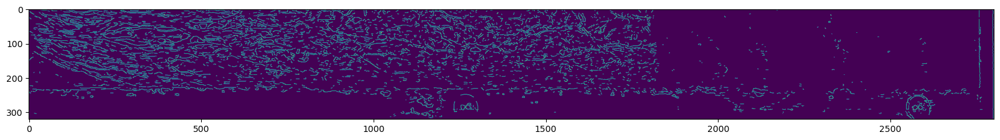

In [93]:
edges2 = cv2.Canny(formating(image), 100, 120)
figure(figsize=(20,20))
plt.imshow(edges2)

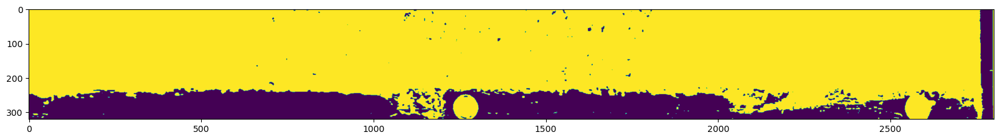

In [28]:

figure(figsize=(20,20))
plt.imshow((formating(image)>30))

In [45]:
msk2

array([[-255, -255, -255, ..., -255, -255, -255],
       [-255, -255, -255, ..., -255, -255, -255],
       [-255, -255, -255, ..., -255, -255, -255],
       ...,
       [-255, -255, -255, ..., -255, -255, -255],
       [-255, -255, -255, ..., -255, -255, -255],
       [-255, -255, -255, ..., -255, -255, -255]], dtype=int16)

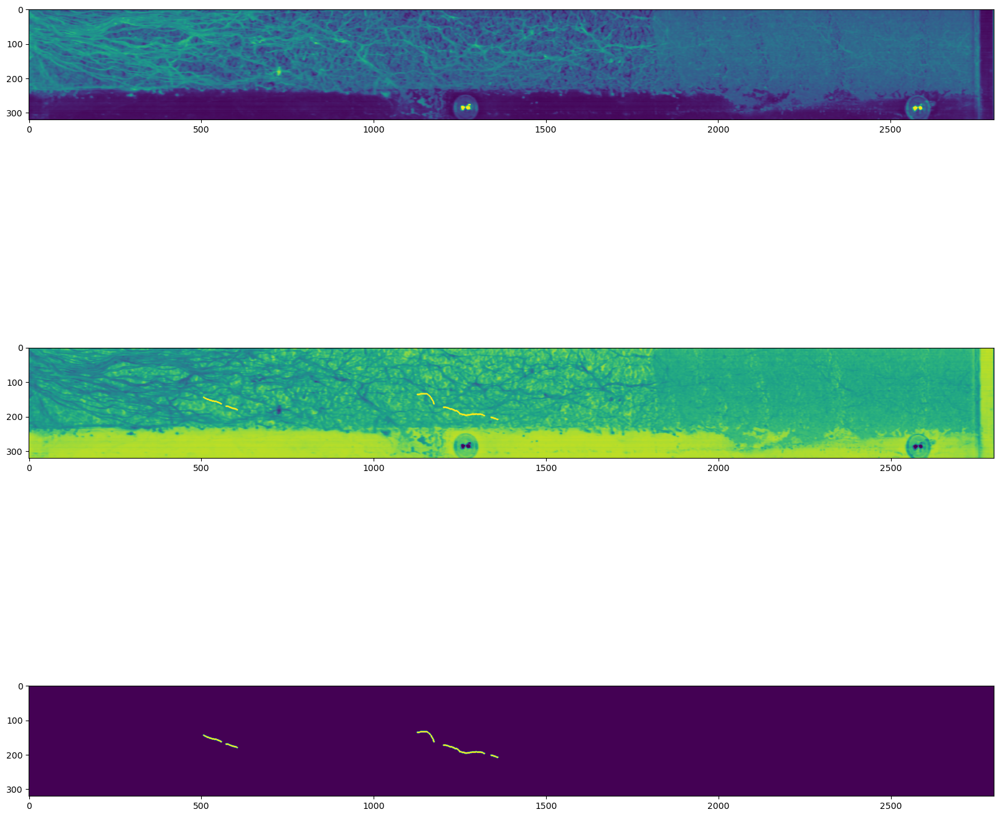

In [83]:
msk2=(msk[:,:,1]-255)*(-1)
msk2=np.flip(msk2,axis=0)
figure(figsize=(20,20))
plt.subplot(3, 1, 1)
plt.imshow(image)
plt.subplot(3, 1, 2)
plt.imshow(msk2*image[:,:2800])
plt.subplot(3, 1, 3)
plt.imshow(msk2)

In [30]:
aligned, al_msk =align_images( formating(template),formating(image),msk=np.rot90(msk) )

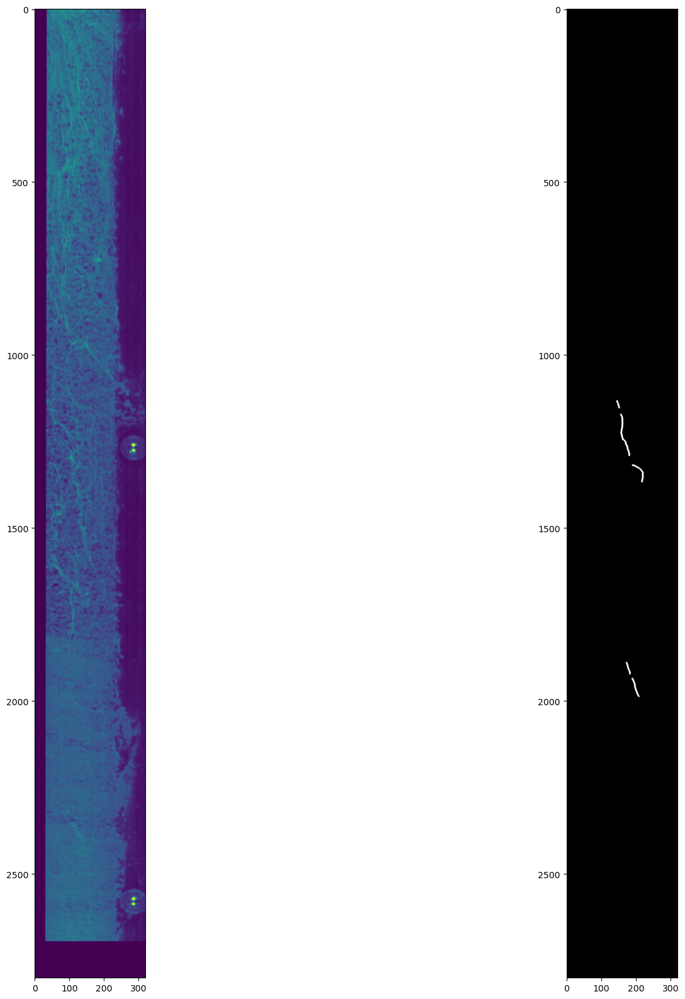

In [31]:
figure(figsize=(20,20))
plt.subplot(1, 2, 1)
plt.imshow(aligned)
plt.subplot(1, 2, 2)
plt.imshow(al_msk)

In [51]:
# align with nir

In [22]:
nir_img.shape
#nir_img2 = cv2.cvtColor(formating(nir_img), cv2.COLOR_BGR2GRAY)
nir_img2 = scaled(nir_img)[:,:,2]
nir_img2 = np.flip(nir_img2, axis=1)

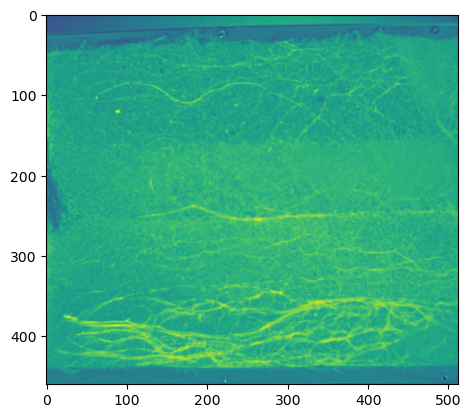

In [60]:
plt.imshow(np.rot90(nir_img2)[:460])

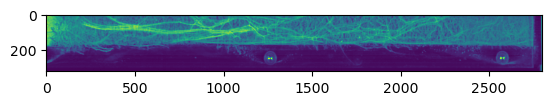

In [53]:
plt.imshow(formating(scaled(image)))

In [56]:
def normalize_by_reference(input_img, ref_img):
    # Get the minimum and maximum pixel values of the reference image
    ref_min = np.min(ref_img)
    ref_max = np.max(ref_img)

    # Get the minimum and maximum pixel values of the input image
    input_min = np.min(input_img)
    input_max = np.max(input_img)

    # Compute the scaling factors for the input image
    scale_min = (ref_min / input_min) if input_min > 0 else 1
    scale_max = ref_max / input_max

    # Apply the scaling factors to the input image
    normalized_img = input_img * scale_min
    normalized_img = np.where(normalized_img > ref_max, ref_max, normalized_img)
    
    return normalized_img

In [71]:
normy = normalize_by_reference(np.rot90(nir_img2)[:460],formating(scaled(image)) )

In [109]:
#eq = cv2.equalizeHist(formating(normy))
clahe = cv2.createCLAHE(tileGridSize=(4,4))
eq = clahe.apply(formating(normy))
eq2 = clahe.apply(formating(scaled(image)))

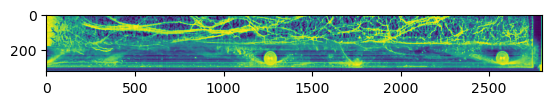

In [110]:
plt.imshow(eq2)

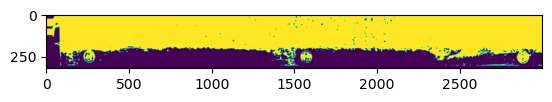

In [32]:
T = formating(template)>30
T = T.astype("uint8")
T = formating(T)
plt.imshow(T)

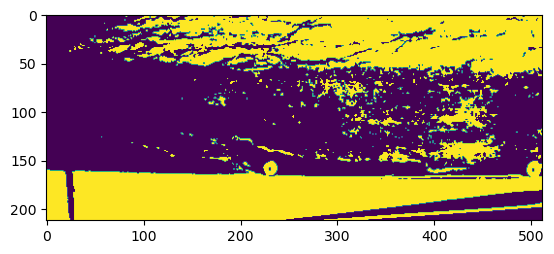

In [41]:
G = gray>80
G = G.astype("uint8")
G = formating(np.rot90(np.flip(G[:,300:], axis=1)))
plt.imshow(G)

In [126]:
aligned,_ =align_images( formating(scaled(eq2)),formating(scaled(eq)), maxFeatures=200) #formating(np.rot90(nir_img2))

In [127]:
aligned.shape

(460, 512)

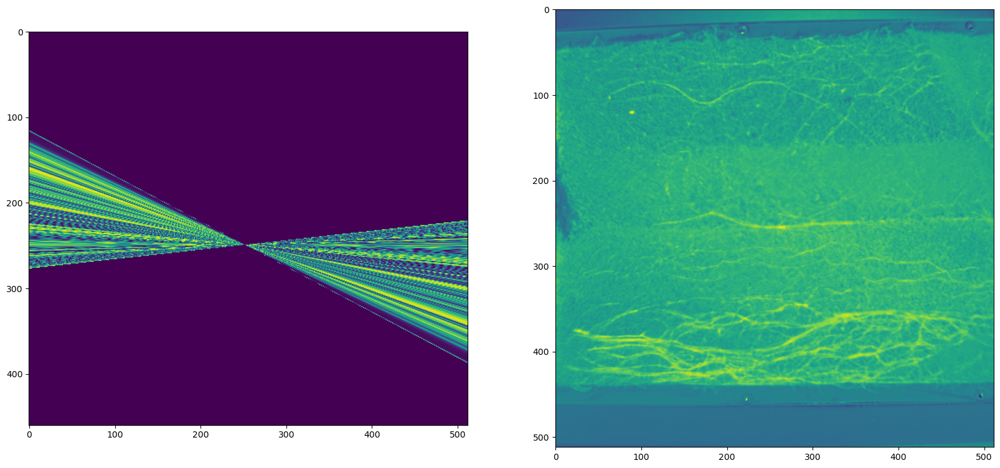

In [128]:
figure(figsize=(20,20))
plt.subplot(1, 2, 1)
plt.imshow(aligned)
plt.subplot(1, 2, 2)
plt.imshow(np.rot90(nir_img2))